Study the decision tree algorithm, focusing on both entropy based information gain and Gini index for splitting. Build decision trees and random forests for the loan datasets.

In [ ]:
import pandas as pd
import numpy as np


In [ ]:
loan_data=pd.read_excel('/content/loan.xlsx')

In [ ]:
loan_data.head(5)

,Sex,Age,Time_at_address,Res_status,Telephone,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,given,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,not_given,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,given,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,not_given,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,given,driver,governmen,0,0,f,given,228,0,reject


In [ ]:
loan_data.head()
#loan_data.drop(columns='Telephone',inplace=True)

In [ ]:
X=loan_data.iloc[:,:-1]
Y=loan_data.iloc[:,-1]

In [ ]:
print(loan_data['Sex'].unique(),loan_data['Res_status'].unique(),loan_data['Occupation'].unique(),loan_data['Job_status'].unique(),loan_data['Acc_ref'].unique())

['M' 'F'] ['owner' 'rent'] ['unemploye' 'labourer' 'creative_' 'driver' 'professio' 'manager'
 'guard_etc' 'executive' 'office_st' 'productio' 'semi_pro' 'sales'] ['unemploye' 'governmen' 'private_s' 'self_empl' 'retired' 'student'
 'military'] ['given' 'oth_inst_']


In [ ]:
one_hot_encoded_data =pd.DataFrame()
x = pd.get_dummies(X, columns = ['Sex','Res_status','Occupation','Job_status','Acc_ref','Liab_ref'])

In [ ]:
features=x.columns
x

,Age,Time_at_address,Time_employed,Time_bank,Home_Expn,Balance,Sex_F,Sex_M,Res_status_owner,Res_status_rent,...,Job_status_military,Job_status_private_s,Job_status_retired,Job_status_self_empl,Job_status_student,Job_status_unemploye,Acc_ref_given,Acc_ref_oth_inst_,Liab_ref_f,Liab_ref_t
0,50.750000,0.585,0,0,145,0,0,1,1,0,...,0,0,0,0,0,1,1,0,1,0
1,19.670000,10.000,0,0,140,0,0,1,0,1,...,0,0,0,0,0,0,1,0,0,1
2,52.830002,15.000,5,14,0,2200,1,0,1,0,...,0,1,0,0,0,0,1,0,1,0
3,22.670000,2.540,2,0,0,0,0,1,0,1,...,0,0,0,0,0,0,1,0,1,0
4,29.250000,13.000,0,0,228,0,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,34.169998,2.750,2,0,232,200,0,1,1,0,...,0,0,0,1,0,0,1,0,0,1
425,22.250000,1.250,3,0,280,0,1,0,0,1,...,0,0,0,0,0,1,1,0,1,0
426,23.330000,1.500,1,0,422,200,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
427,21.000000,4.790,2,1,80,300,0,1,0,1,...,0,1,0,0,0,0,1,0,0,1


In [ ]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
y=le.fit_transform(Y)

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test=train_test_split(x,y,test_size=0.25,random_state=1)

Using Entropy method

In [ ]:
from sklearn import tree
dt_entropy = tree.DecisionTreeClassifier(criterion='entropy')

In [ ]:
dt_entropy = dt_entropy.fit(X_train,Y_train)

In [ ]:
y_pred = dt_entropy.predict(X_test)
y_pred

array([1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1,
       0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1,
       1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [ ]:
result_entropy=pd.DataFrame()
result_entropy['Y_test']=Y_test
result_entropy['Predicted Result']=y_pred
result_entropy

,Y_test,Predicted Result
0,1,1
1,0,1
2,1,1
3,0,1
4,0,0
...,...,...
103,1,1
104,1,1
105,0,1
106,1,1


In [ ]:
from sklearn.metrics import accuracy_score
print(accuracy_score(Y_test, y_pred))

0.6388888888888888


In [ ]:
dt_entropy.feature_importances_

array([0.08893267, 0.11004532, 0.09773906, 0.25684296, 0.0987541 ,
       0.12594388, 0.        , 0.        , 0.01988928, 0.0062728 ,
       0.01910908, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.03692984, 0.03918349, 0.01017796, 0.01093621,
       0.01260289, 0.01295486, 0.        , 0.        , 0.02331812,
       0.        , 0.01514105, 0.        , 0.        , 0.        ,
       0.01522644, 0.        , 0.        ])

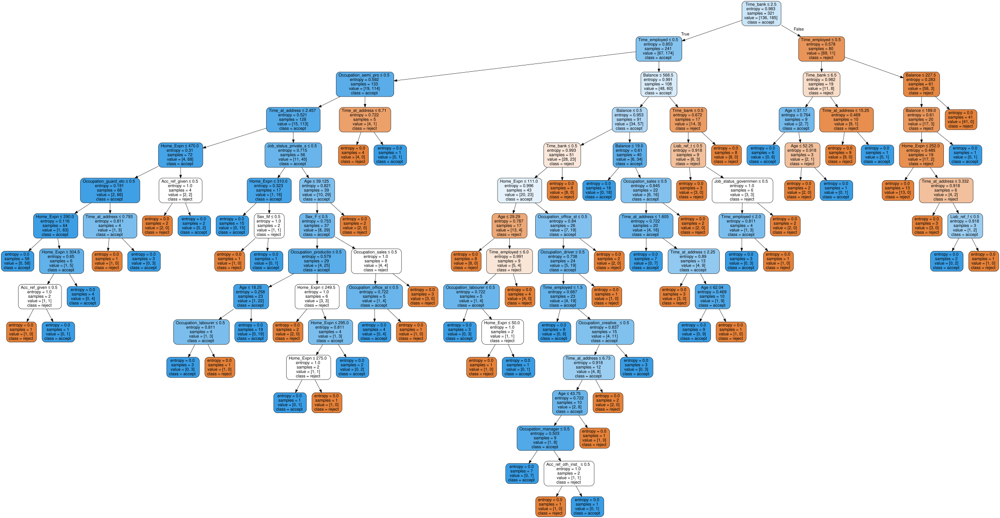

In [ ]:
dot_data = tree.export_graphviz(dt_entropy, out_file=None, 
                      filled=True,feature_names=features,class_names=['reject','accept'], rounded=True,  
                      special_characters=True)  
graph = graphviz.Source(dot_data)  
graph
#graph.render('diagram')

Using Gini Method-Decision Tree

In [ ]:
dt_gini=tree.DecisionTreeClassifier(criterion='gini')

In [ ]:
dt_gini.fit(X_train,Y_train)

DecisionTreeClassifier()

In [ ]:
y_pred2=dt_gini.predict(X_test)

In [ ]:
result_gini=pd.DataFrame()
result_gini['Y_test']=Y_test
result_gini['Predicted Result']=y_pred2
result_gini

,Y_test,Predicted Result
0,1,1
1,0,1
2,1,1
3,0,1
4,0,0
...,...,...
103,1,1
104,1,1
105,0,1
106,1,1


In [ ]:
from sklearn.metrics import accuracy_score
print(accuracy_score(Y_test, y_pred2))

0.6851851851851852


In [ ]:
dt_gini.feature_importances_

array([0.0617707 , 0.10065383, 0.12507406, 0.3247488 , 0.07656031,
       0.13116366, 0.01679849, 0.00850556, 0.00956876, 0.        ,
       0.02654631, 0.00834377, 0.        , 0.01275835, 0.        ,
       0.00567038, 0.01476206, 0.00170111, 0.01107441, 0.00162327,
       0.02862369, 0.        , 0.00478438, 0.        , 0.        ,
       0.        , 0.001625  , 0.        , 0.        , 0.        ,
       0.00850556, 0.00637917, 0.01275835])

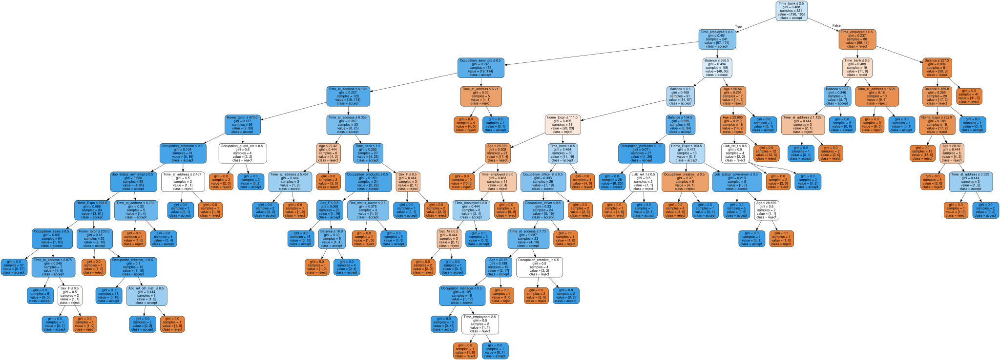

In [ ]:
dot_data1 = tree.export_graphviz(dt_gini, out_file=None, 
                      filled=True,feature_names=features,class_names=['reject','accept'], rounded=True,  
                      special_characters=True)  
graph = graphviz.Source(dot_data1)  
graph
#graph.render('diagram2')

**Random Forest Implementation**






In [ ]:
from sklearn.ensemble import RandomForestClassifier

Using Gini Method

In [ ]:
clf=RandomForestClassifier(n_estimators=1000,criterion='gini')

In [ ]:
clf.fit(X_train,Y_train)

RandomForestClassifier(n_estimators=1000)

In [ ]:
y_pred_RandomForest=clf.predict(X_test)

In [ ]:
from sklearn import metrics
print("Accuracy:",metrics.accuracy_score(Y_test, y_pred_RandomForest))
print(metrics.classification_report(Y_test,y_pred_RandomForest))

Accuracy: 0.75
              precision    recall  f1-score   support

           0       0.94      0.55      0.70        56
           1       0.67      0.96      0.79        52

    accuracy                           0.75       108
   macro avg       0.80      0.76      0.74       108
weighted avg       0.81      0.75      0.74       108



In [218]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(nrows = 1,ncols = 6,figsize = (10,5), dpi=3000)
for index in range(0, 6):
    tree.plot_tree(clf.estimators_[index], feature_names = features,class_names=['reject','accept'],filled = True,ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)

Using Entropy Method

In [ ]:
clf_entropy=RandomForestClassifier(criterion='entropy')

In [ ]:
clf_entropy.fit(X_train,Y_train)

RandomForestClassifier(criterion='entropy')

In [ ]:
y_pred_entropy=clf_entropy.predict(X_test)

In [ ]:
from sklearn import metrics
print("Accuracy:",metrics.accuracy_score(Y_test, y_pred_entropy))
print(metrics.classification_report(Y_test,y_pred_entropy))


Accuracy: 0.7685185185185185
              precision    recall  f1-score   support

           0       0.94      0.59      0.73        56
           1       0.68      0.96      0.80        52

    accuracy                           0.77       108
   macro avg       0.81      0.78      0.76       108
weighted avg       0.82      0.77      0.76       108



In [219]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(nrows = 1,ncols = 6,figsize = (10,5), dpi=3000)
for index in range(0, 6):
    tree.plot_tree(clf_entropy.estimators_[index],feature_names = features, class_names=['reject','accept'],filled = True, ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)